In [ ]:
#Mount Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install -q efficientnet

In [ ]:

# CurrentWorkingDirectory = "/content/drive/My Drive/Deep_Learning_Assignments/Project/EDA_Wheat_Rust/"
CurrentWorkingDirectory = "/content/drive/My Drive/Deep_Learning_Assignments/Project/"
DATA_PATH = CurrentWorkingDirectory+"data/"
IMAGE_PATH = DATA_PATH + "train/"
IMAGE_healthy_wheat = IMAGE_PATH+"healthy_wheat/"
IMAGE_leaf_rust = IMAGE_PATH+"leaf_rust/"
IMAGE_stem_rust = IMAGE_PATH+"stem_rust/"
tejas_path = CurrentWorkingDirectory+"tejas/"
pickle_files = tejas_path+"pickle_files/"
train_imgs_path = pickle_files+"train_imgs_list.pkl"
leaf_rust_path = pickle_files+ "lr.pkl"
healthy_wheat_path = pickle_files + "hw.pkl"
stem_rust_path = pickle_files +"wr.pkl"

train_pkl_paths = [leaf_rust_path,healthy_wheat_path,stem_rust_path]

IMAGE_classes = [IMAGE_leaf_rust,IMAGE_healthy_wheat,IMAGE_stem_rust]
classes = ["leaf_rust","healthy_wheat","stem_rust"] #labels are according to this order [0,1,2]
label2class = {0:classes[0],1:classes[1],2:classes[2]} #index to class mapping
num_cls = 3

In [ ]:
import os
import gc
import re
import pickle

import os.path
from os import path
from PIL import Image
import cv2
import imageio
import math
import numpy as np
import scipy as sp
import pandas as pd

import tensorflow as tf
from IPython.display import SVG
import efficientnet.tfkeras as efn
from keras.utils import plot_model
import tensorflow.keras.layers as L
from keras.utils import model_to_dot
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model
# from kaggle_datasets import KaggleDatasets
from tensorflow.keras.applications import DenseNet121


import seaborn as sns
from tqdm import tqdm
import matplotlib.cm as cm
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

# tqdm.pandas()
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

np.random.seed(0)
tf.random.set_random_seed(0)

import warnings
warnings.filterwarnings("ignore")

In [ ]:
#------------------------STANDARD I/O FUNCTIONS-------------------------------------------------
def appendToCSV(row,filepath):
	with open(filepath,"a",buffering = 1) as csvfile:
		writer = csv.writer(csvfile)
		writer.writerow(row)

def openCSVfile(filepath):
	with open(filepath,"r") as csvfile:
		rows =  csv.reader(csvfile,delimiter = ",")
		return list(rows)

def loadPickleFile(filepath):
	print("Loading the pickle file from",filepath,"...........")
	pickle_in = open(filepath,"rb")
	example_dict = pickle.load(pickle_in)
	print("Loaded the pickle File")
	return example_dict

def dumpPickleFile(data,filepath):
	pickle_out = open(filepath,"wb")
	print("Dumping the Pickle file into ",filepath,"...........")
	pickle.dump(data, pickle_out)
	print("Dumped the pickle File")
	pickle_out.close()

In [ ]:
def load_image(fname,Dir):
    # file_path = image_id + ".jpg"
    # image = cv2.imread(Dir+fname)
    image = cv2.imread(Dir+fname)
    # print(type(image))
    # print(fname)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [ ]:
valid_non_jpg = ['JDOHI8.png', '6MCD3S.png', '0FX4J2.png', 'DHNL92.jpeg', 'F7B6FL.jpeg', 'PYMK1M.png', 'OSGBUW.png', 'KBOWUM.png', '76FFDO.png']
train_images = []
train_labels = []
class_img = []
class_lbl = []
y = -1
cnt = 0
num_img = 0
non_jpg = 0
cnt_valid_non_jpg =0
non_jpg_names = []
# img_set = set()
for Dir in IMAGE_classes:
    imgs = []
    lbl = []
    y+=1
    print("Directory: ",Dir)
    for filename in os.listdir(Dir):
        # print(filename)
        if filename[-3:].lower()!= "jpg":
            non_jpg+=1
            non_jpg_names.append(filename)
            if(filename not in valid_non_jpg):
                continue
            else:
              cnt_valid_non_jpg+=1
        num_img+=1
        # print("IMG no.",num_img)
        try:
            img = load_image(filename,Dir)
        except Exception as e:
            print(e)
            print(filename)
            cnt+=1
            continue

        imgs.append(img)
        lbl.append(y)
    class_img.append(imgs)
    class_lbl.append(lbl)
    print("Size of: ", label2class[y]," ",len(class_img[y]))
    train_images.extend(imgs)
    train_labels.extend(lbl)

print("Cnt",cnt,"valid_non_jpg",valid_non_jpg)
train_size = len(train_images)
print(train_size,non_jpg)
print(non_jpg_names)

Directory:  /content/drive/My Drive/Deep_Learning_Assignments/Project/data/train/leaf_rust/
Size of:  leaf_rust   358
Directory:  /content/drive/My Drive/Deep_Learning_Assignments/Project/data/train/healthy_wheat/
Size of:  healthy_wheat   142
Directory:  /content/drive/My Drive/Deep_Learning_Assignments/Project/data/train/stem_rust/
Size of:  stem_rust   376
Cnt 0 valid_non_jpg ['JDOHI8.png', '6MCD3S.png', '0FX4J2.png', 'DHNL92.jpeg', 'F7B6FL.jpeg', 'PYMK1M.png', 'OSGBUW.png', 'KBOWUM.png', '76FFDO.png']
876 323
['WMDHS9.jfif', 'LL75XT.jfif', 'TIZBDT.jfif', 'XL8JYZ.jfif', 'JDOHI8.png', 'AVI32D.jfif', 'UBR48B.jfif', 'AVFGNY.jfif', 'XVTYNS.jfif', 'XBPTGT.jfif', 'NJYIEE.jfif', 'MXU8AZ.jfif', 'FHZTQ9.jfif', 'T4PTSX.jfif', 'L31ZYT.jfif', 'QUQYBO.jfif', '8K4OWH.jfif', 'Z0WJ1I.jfif', '5QLT82.jfif', 'M0ILRH.jfif', 'OM7PN0.jfif', '00VVPB.jfif', '3WPXWE.jfif', '2XML6U.jfif', 'N8YT33.jfif', 'CV1X36.jfif', 'QSOJNJ.jfif', 'YWGB88.jfif', '6616DF.jfif', 'USXKL2.jfif', '5PNZRU.jfif', 'LPUQZ3.jfif', '

Distribution of Classes

876
leaf_rust 358
healthy_wheat 142
stem_rust 376


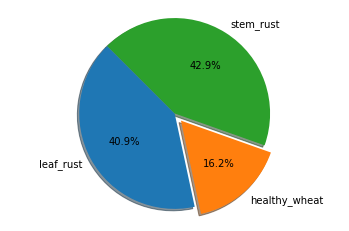

In [ ]:
# classes = ["leaf_rust","healthy_wheat","stem_rust"] #labels are according to this order [0,1,2]
# 358,142,376
print(len(train_images))
class_sizes = [0]*num_cls
for i in range(num_cls):
  print(label2class[i],len(class_img[i]))
  class_sizes[i]  = len(class_img[i])

# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = classes
sizes = class_sizes
explode = (0, 0.1, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=135)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

# Pickling Attempt


In [ ]:
# num_class = 3
# for i in range(num_class):
#   print(len(train_images[i]),train_labels[i][0],IMAGE_classes[i])

In [ ]:
# def pickle_pair(train_images,train_labels,path):
#     '''pickles images and labels'''
#     X = train_images
#     Y= train_labels
#     train_data = [X,Y]
#     # if(train_size==876):
#     dumpPickleFile(train_data,path)

In [ ]:
# num_class = 3
# for i in range(num_class):
#   print(len(train_images[i]),train_labels[i][0],IMAGE_classes[i])

In [ ]:
# num_class = 3
# '''Leaf_rust complete'''
# for i in range(2,num_class):
#     print(len(train_images[i]),train_labels[i][0],classes[i])
#     pickle_pair(train_images[i],train_labels[i],train_pkl_paths[i])

In [ ]:
# '''Converting all to JPG'''

# train_images = []
# train_labels = []
# y = -1
# cnt = 0
# num_img = 0
# non_jpg = 0
# non_jpg_names = []
# # img_set = set()
# for Dir in IMAGE_classes:
#     y+=1
#     print("Directory: ",Dir)
#     for filename in os.listdir(Dir):
#         # print(filename)
#         if filename[-3:].lower()!= "jpg":
#             non_jpg+=1
#             non_jpg_names.append(filename)
#             try:
#                 img = Image.open(Dir+filename)
#             except Exception as e:
#                 print(e)
#                 # print("Invalid image file")
#                 print(Dir+filename)
#                 continue
#             # print(Dir+filename[:-4])
#             img = img.convert('RGB')
#             filename = filename[:-4]+".jpg"
#             if not path.exists(Dir+filename):
#                 img.save(Dir+filename)
#             # Image.open(Dir+filename).convert('RGB').save('7U06EV.jpg')
#             continue
#         num_img+=1
#         print("IMG no.",num_img)
#         try:
#             img = load_image(filename,Dir)
#         except Exception as e:
#             print(e)
#             print(filename)
#             cnt+=1
#             continue
#             # cnt+=1
#             # print(filename)
#             # try:
#             #     img = Image.open(Dir+filename)
#             # except:
#             #     print("Invalid image file")
#             #     print(Dir+filename)
#             #     continue
#             # # print(Dir+filename[:-4])
#             # img = img.convert('RGB')
#             # filename = filename[:-4]+".jpg"
#             # if not path.exists(Dir+filename):
#             #     img.save(Dir+filename)
#             # # Image.open(Dir+filename).convert('RGB').save('7U06EV.jpg')
#             # img = load_image(filename,Dir)
#         # if filename not in img_set:
#         # img_set.add(filename)
#         train_images.append(img)
#         train_labels.append(y)

# print("Cnt",cnt)
# train_size = len(train_images)
# print(train_size,non_jpg)
# print(non_jpg_names)
# X = train_images
# Y= train_labels
# train_data = [X,Y]
# if(train_size==876):
#     dumpPickleFile(train_data,train_imgs_path)
# # filename = "7U06EV.gif"
# # Dir = IMAGE_leaf_rust

# # img = Image.open(Dir+filename)
# # print(Dir+filename[:-4])
# # img = img.convert('RGB')
# # img.save(Dir+filename[:-4]+".jpg")
# # # Image.open(Dir+filename).convert('RGB').save('7U06EV.jpg')
# # filename = "7U06EV.jpg"
# # Dir = IMAGE_leaf_rust
# # img = load_image(filename,Dir)
# # train_images.append(img)
# # train_labels.append(y)



# # img = load_image(filename,Dir)
# # train_images.append(img)
# # train_labels.append(y)

In [ ]:
# f = ['WMDHS9.jfif', 'LL75XT.jfif', 'TIZBDT.jfif', 'XL8JYZ.jfif', 'JDOHI8.png', 'AVI32D.jfif', 'UBR48B.jfif', 'AVFGNY.jfif', 'XVTYNS.jfif', 'XBPTGT.jfif', 'NJYIEE.jfif', 'MXU8AZ.jfif', 'FHZTQ9.jfif', 'T4PTSX.jfif', 'L31ZYT.jfif', 'QUQYBO.jfif', '8K4OWH.jfif', 'Z0WJ1I.jfif', '5QLT82.jfif', 'M0ILRH.jfif', 'OM7PN0.jfif', '00VVPB.jfif', '3WPXWE.jfif', '2XML6U.jfif', 'N8YT33.jfif', 'CV1X36.jfif', 'QSOJNJ.jfif', 'YWGB88.jfif', '6616DF.jfif', 'USXKL2.jfif', '5PNZRU.jfif', 'LPUQZ3.jfif', 'D5PGB3.jfif', 'DY6IE7.jfif', '7U06EV.gif', 'M3T8YX.jfif', 'K1TXKT.jfif', 'RCHIOR.jfif', 'EGGGXN.jfif', '39MD1S.jfif', '56N2ZN.jfif', 'ZEJJEC.jfif', 'RVMAIV.jfif', '6MCD3S.png', '10E2V7.jfif', '2ECI4X.jfif', 'GNJ5MY.jfif', 'LLHLQN.jfif', '0FX4J2.png', 'YVFWPK.jfif', '5A0INM.jfif', 'S1KKJT.jfif', 'FA0EDN.jfif', 'GJFBJA.jfif', 'V35M9N.jfif', '2SDHKR.jfif', 'DLK2JF.jfif', 'SZOIRZ.jfif', '4XQEM2.jfif', 'NWYA7Q.jfif', 'DHNL92.jpeg', 'PMDLCY.jfif', 'DTL2GK.jfif', 'ZX44PV.jfif', '9BEZ15.jfif', 'ETPVUI.jfif', 'MAPKID.jfif', 'KB6UJ7.jfif', 'C25GLO.jfif', 'CU1Z91.jfif', '7X8ZKT.jfif', 'EE7W88.jfif', 'D13IJI.jfif', '7LQK3F.jfif', 'M6WFHJ.jfif', '1TON58.jfif', 'M6X1CL.jfif', 'Y1OCV6.jfif', '8XR87D.jfif', 'A6U5K9.jfif', 'QNDFZN.jfif', 'GIYV8B.jfif', 'FNOMOO.jfif', 'IXRCZL.jfif', 'Q84CBV.jfif', 'HNDRV1.jfif', 'BUCKBW.jfif', 'PTAWZS.jfif', '392Z3F.jfif', '92C0OY.jfif', 'Y5CD5T.jfif', '1DV8YN.jfif', 'Q5Z10Q.jfif', '8WGAGZ.jfif', 'SFGBTU.jfif', 'F454R9.jfif', 'G7IG7A.jfif', 'F7B6FL.jpeg', 'ZPDG7D.jfif', '1PE28T.jfif', 'PYMK1M.png', 'N08DX6.jfif', 'OSGBUW.png', 'HIYN7I.jfif', 'X7VO5R.jfif', '209QWE.jfif', 'YL98WR.jfif', 'IEWYAC.jfif', '85MTOL.jfif', 'GNJ5IO.jfif', '6V9W4D.jfif', 'IIHVXF.jfif', 'PE7CXT.jfif', '6IW1HK.jfif', 'WRCRVM.jfif', '1I3ADK.jfif', 'CN42FG.jfif', 'SNIXDK.jfif', 'ANFXXI.jfif', 'WALGOP.jfif', 'M56ORX.jfif', '8PMCCH.jfif', '274LI8.jfif', 'H51PAY.jfif', 'FVQOKA.jfif', 'CVL5BO.jfif', 'PXDNTX.jfif', 'HN3EVU.jfif', 'MM0NJB.jfif', 'V2AEGW.jfif', '7NK9AN.jfif', 'BX298Q.jfif', 'IUBFHR.jfif', 'M1GMBO.jfif', 'EY85XM.jfif', '7V5AZ4.jfif', 'KBOWUM.png', 'T5VD54.jfif', '82T4LM.jfif', '3J5833.jfif', '5C3950.jfif', '2JE5S8.jfif', 'VCBKV0.jfif', 'BK1GNK.jfif', '5UARHB.jfif', 'GUOSF7.jfif', '0DEA0V.jfif', 'ZZFXJM.jfif', 'K132UQ.jfif', 'EW97KQ.jfif', 'T0C1CQ.jfif', 'FGVWJ9.jfif', 'QJY255.jfif', 'W6WEQV.jfif', 'XGXKYD.jfif', 'L9X0VQ.jfif', '7IIMFZ.jfif', 'TRRES0.jfif', '7KLUT5.jfif', 'LDZZ1L.jfif', '76FFDO.png', 'SVKFBF.jfif', 'K6IUZW.jfif', '83RYYY.jfif', 'LW1FDD.jfif', 'AM369S.jfif', '83HZBW.jfif', 'IPRUZ7.jfif', 'C6VM7G.jfif', 'U79ACG.jfif', 'K2KIE8.jfif', 'LHTBF1.jfif', 'UL35NF.jfif', 'I9SSTW.jfif', 'C25QRM.jfif', '34QL3W.jfif', '2Y27GQ.jfif', 'T9DUFH.jfif', 'IRWU5H.jfif', '0O5BON.jfif', 'N8O0C1.jfif', 'MW2YLX.jfif', '75H6R9.jfif', 'EJ8295.jfif', 'C572GK.jfif', 'OAHCEM.jfif', 'TTIIYZ.jfif', '9ZEVXL.jfif', 'AQKHOK.jfif', 'R1GKEP.jfif', 'NP6250.jfif', 'TZCKHA.jfif', 'IL9FCV.jfif', 'CHT342.jfif', '33J5MM.jfif', '3GTKZJ.jfif', '5HV6KU.jfif', '56APML.jfif', 'WGJ7NJ.jfif', '7ITAYE.jfif', 'JXN0ZP.jfif', 'DKP3ZM.jfif', 'NQ15I3.jfif', '74ZPA9.jfif', 'C5BGP5.jfif', '508FIK.jfif', 'NH4TNJ.jfif', '3VZ47F.jfif', 'VLXEK6.jfif', 'SJ54T5.jfif', 'DSZYA9.jfif', 'CHJDTJ.jfif', 'SWPUMU.jfif', '3Q0E0P.jfif', '8NB5J3.jfif', 'U0P84E.jfif', 'UP510H.jfif', '1LNMUQ.jfif', 'HNUJLZ.jfif', '03TD19.jfif', 'HV8FS9.jfif', 'DJO3I3.jfif', '89HHA3.jfif', 'DJVBU8.jfif', 'E7W6KS.jfif', 'M97WV0.jfif', 'R2EUB2.jfif', '8GXR21.jfif', 'F44CKW.jfif', '7RGDDG.jfif', 'IXCBUE.jfif', 'CHGSLB.jfif', 'Y6OVRX.jfif', '67AESM.jfif', 'EBMMCD.jfif', 'GKK6S3.jfif', 'R7MQ3K.jfif', '6T5756.jfif', 'S0V7NA.jfif', '4DMP66.jfif', 'M0B7CV.jfif', '7KUFEH.jfif', '3OKS1S.jfif', 'QJGRTR.jfif', 'N1HIQM.jfif', 'AFCENX.jfif', 'N0XG6F.jfif', 'BXPXA7.jfif', '6N1U85.jfif', '2XYE4I.jfif', '9PBQ07.jfif', '3T864F.jfif', 'XW6EIA.jfif', 'G63JGO.jfif', 'ULWQAO.jfif', 'L54H4D.jfif', 'D9D9YO.jfif', 'M2JYF7.jfif', 'VH1QHY.jfif', 'ISRIWC.jfif', 'DT9HU4.jfif', '2C20JO.jfif', 'GXFMJU.jfif', 'U79432.jfif', '4HPNQR.jfif', 'B0OGTU.jfif', 'GZ3DJ9.jfif', 'FLY31D.jfif', 'B72F55.jfif', 'H7KBSS.jfif', 'SA4IZE.jfif', 'ITHJH3.jfif', '10B6P0.jfif', '9SLSPS.jfif', 'IFQPSK.jfif', 'Q5W30V.jfif', 'HMBXAG.jfif', 'CMBUFU.jfif', 'N1H2TZ.jfif', '0CXDTY.jfif', 'D3IETN.jfif', 'ZF2C96.jfif', 'OXB7BD.jfif', 'O4CB00.jfif', '2J1PQ4.jfif', '5RG24C.jfif', 'SEKZYY.jfif', 'D0E3GS.jfif', 'DFRU3F.jfif', '59FBYS.jfif', 'V58S56.jfif', '55E81Z.jfif', 'W2JUB6.jfif', 'U2V5YV.jfif', '68K0BF.jfif', '120LEV.jfif', 'ZF5LOB.jfif', '1YHZHR.jfif', 'XV81OY.jfif', 'OLZW86.jfif', '2RCVZ9.jfif', 'R4S1SH.jfif', 'ZDLMKT.jfif', '6E4H6K.jfif', '23ZAZ8.jfif', 'U32C73.jfif', '6JT8MO.jfif', 'WWX0LN.jfif', 'NDBROB.jfif', '81QY5L.jfif', '5A1I6X.jfif', 'MLOC1X.jfif', 'DR8HQ5.jfif', 'X39Q4J.jfif', 'EVC1PX.jfif', 'FFV2P1.jfif', '84YCLL.jfif', 'M2YMPN.jfif', '3TZ5AZ.jfif', 'IY24RW.jfif', '11F0U1.jfif', 'UT5W0J.jfif', 'XUDDKP.jfif']
# l = []
# for x in f:
#     if x.find("jfif")==-1 and x.find("gif")==-1:
#         l.append(x)
# print(l)
# print(len(l))

# Load sample images


Visualizing images of each class


In [ ]:
def show_img(train_images):
  fig = px.imshow(cv2.resize(train_images[0], (500,500)))
  fig.show()

In [ ]:
for i in range(num_cls):
  print(label2class[i])
  show_img(class_img[i])

leaf_rust


healthy_wheat


stem_rust


I have plotted the first image in the training data above (the RGB values can be seen by hovering over the image). The green parts of the image have very low red values, but by contrast, the brown parts have high red values. This suggests that green (healthy) parts of the image have low red values, whereas unhealthy parts are more likely to have high red values. This might suggest that the red channel may be the key to detecting diseases in plants.

# Channel distributions

In [ ]:
red_values = [np.mean(train_images[idx][:, :, 0]) for idx in range(len(train_images))]
green_values = [np.mean(train_images[idx][:, :, 1]) for idx in range(len(train_images))]
blue_values = [np.mean(train_images[idx][:, :, 2]) for idx in range(len(train_images))]
values = [np.mean(train_images[idx]) for idx in range(len(train_images))]

### All channel values

In [ ]:
fig = ff.create_distplot([values], group_labels=["Channels"], colors=["purple"])
fig.update_layout(showlegend=True)
fig.update_layout(title_text="Distribution of channel values")

# The channel values seem to have a roughly normal distribution centered around 106. The maximum channel activation is 255. This means that the average channel value is less than half the maximum value, which indicates that channels are minimally activated most of the time.

### Red channel values

In [ ]:
fig = ff.create_distplot([red_values], group_labels=["R"], colors=["red"])
fig.update_layout(showlegend=False)
fig.update_layout(title_text="Distribution of red channel values")

The red channel values seem to roughly normal distribution. There is not a high variation in average red values across images as the peak is low.

### Green Channel Values

In [ ]:
fig = ff.create_distplot([green_values], group_labels=["G"], colors=["green"])
fig.update_layout(showlegend=False)
fig.update_layout(title_text="Distribution of green channel values")

The green channel values have a more uniform distribution than the red channel values, with a smaller peak.



### Blue channel values

In [ ]:
fig = ff.create_distplot([blue_values], group_labels=["B"], colors=["blue"])
fig.update_layout(showlegend=False)
fig.update_layout(title_text="Distribution of blue channel values")

The red channel is positively skewed which implies that the mean and median will be greater than the mode.

### All channel values (together)

In [ ]:
fig = go.Figure()

for idx, values in enumerate([red_values, green_values, blue_values]):
    if idx == 0:
        color = "Red"
    if idx == 1:
        color = "Green"
    if idx == 2:
        color = "Blue"
    fig.add_trace(go.Box(x=[color]*len(values), y=values, name=color, marker=dict(color=color.lower())))

fig.update_layout(yaxis_title="Mean value", xaxis_title="Color channel", title="Mean value vs. Color channel")

In [ ]:
fig = ff.create_distplot([red_values, green_values, blue_values],
                         group_labels=["R", "G", "B"],
                         colors=["red", "green", "blue"])
fig.update_layout(title_text="Distribution of red channel values")

From the above plots, we can clearly see which colors are more common and which ones less common in the leaf images. Green is the most pronounced color, followed by red and blue respectively. The distributions, when plotted together, appear to have a similar shape, but shifted horizontally

# Image processing and augmentation <a id="2"></a>

## Canny edge detection <a id="2.1"></a>

Canny is a popular edge detection algorithm, and as the name suggests, it detects the edges of objects present in an image. It was developed by John F. Canny in 1986. The algorithm involves several steps.

1. **Noise reduction:** Since edge detection is susceptible to noise in an image, we remove the noise in the image using a 5x5 Gaussian filter.


2. **Finding Intensity Gradient of the Image**: The smoothened image is then filtered with a Sobel kernel in both horizontal and vertical directions to get the first derivative in the horizontal (*G<sub>x</sub>*) and vertical (*G<sub>y</sub>*) directions. From these two images, one can find the edge gradient and direction for each pixel:

<center><img src="https://i.imgur.com/ntyjTep.png" width="300px"></center>
<center><img src="https://i.imgur.com/75qDjv6.png" width="260px"></center>

<br>

3. **Rounding:** The gradient is always perpendicular to edges. So, it is rounded to one of the four angles representing vertical, horizontal and two diagonal directions.

4. **Non-maximum suppression:** After getting the gradient magnitude and direction, a full scan of the image is done to remove any unwanted pixels which may not constitute the edge. For this, we check every pixel for being a local maximum in its neighborhood in the direction of the gradient.

5. **Hysteresis Thresholding:** This stage decides which parts are edges and which are not. For this, we need two threshold values, *minVal* and *maxVal*. Any edges with intensity gradient greater than *maxVal* are considered edges and those lesser than *minVal* are considered non-edges, and discarded. Those who lie between these two thresholds are classified edges or non-edges based on their neighborhood. If they are near “sure-edge” pixels, they are considered edges, and otherwise, they are discarded.

The result of these five steps is a two-dimensional binary map (0 or 255) indicating the location of edges on the image. Canny edge is demonstrated below with a few leaf images:

In [ ]:
def edge_and_cut(img):
    emb_img = img.copy()
    edges = cv2.Canny(img, 100, 200)
    edge_coors = []
    for i in range(edges.shape[0]):
        for j in range(edges.shape[1]):
            if edges[i][j] != 0:
                edge_coors.append((i, j))

    row_min = edge_coors[np.argsort([coor[0] for coor in edge_coors])[0]][0]
    row_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][0]
    col_min = edge_coors[np.argsort([coor[1] for coor in edge_coors])[0]][1]
    col_max = edge_coors[np.argsort([coor[1] for coor in edge_coors])[-1]][1]
    new_img = img[row_min:row_max, col_min:col_max]

    emb_img[row_min-10:row_min+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_max-10:row_max+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_min:row_max, col_min-10:col_min+10] = [255, 0, 0]
    emb_img[row_min:row_max, col_max-10:col_max+10] = [255, 0, 0]

    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15, 15))
    ax[0].imshow(img, cmap='gray')
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(edges, cmap='gray')
    ax[1].set_title('Canny Edges', fontsize=24)
    ax[2].imshow(emb_img, cmap='gray')
    ax[2].set_title('Bounding Box', fontsize=24)
    plt.show()

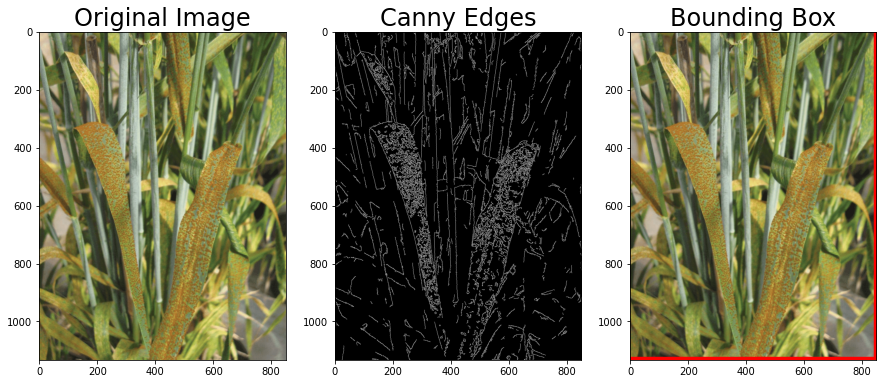

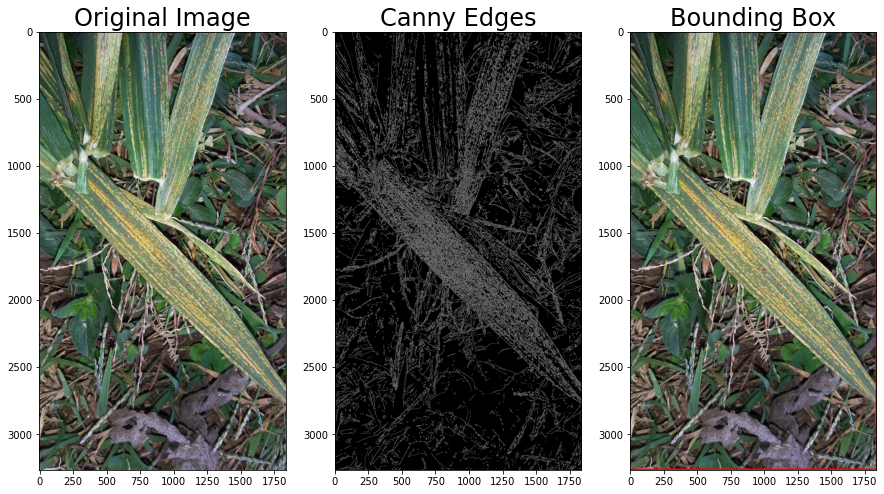

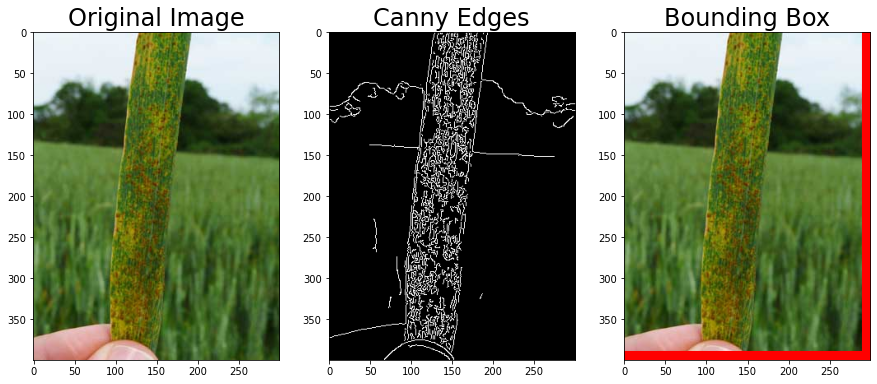

In [ ]:
edge_and_cut(train_images[3])
edge_and_cut(train_images[4])
edge_and_cut(train_images[5])

The second column of images above contains the Canny edges and the third column contains cropped images. I have taken the Canny edges and used it to predict a bounding box in which the actual leaf is contained. The most extreme edges at the four corners of the image are the vertices of the bounding box. This red box is likely to contain most of if not all of the leaf. These edges and bounding boxes can be used to build more accurate models.

## Flipping <a id="2.2"></a>

Flipping is a simple transformation that involves index-switching on the image channels. In vertical flipping, the order of rows is exchanged, whereas in vertical flipping, the order of rows is exchanged. Let us assume that *A<sub>ijk</sub>* (of size *(m, n, 3)*) is the image we want to flip. Horizontal and vertical flipping can be represented by the transformations below:

<center><img src="https://i.imgur.com/B9y5apl.png" width="135px"></center>
<center><img src="https://i.imgur.com/eQ1dyvN.png" width="305px"></center>
<center><img src="https://i.imgur.com/i30LQgq.png" width="305px"></center>
<br>

We can see that the order of columns is exchanged in horizontal flipping. While the *i* and *k* indices remain the same, the *j* index reverses. Whereas, in vertical flipping, the order of rows is exchanged in horizontal flipping. While the *j* and *k* indices remain the same, the *i* index reverses.



In [ ]:
def invert(img):
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15, 15))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.flip(img, 0))
    ax[1].set_title('Vertical Flip', fontsize=24)
    ax[2].imshow(cv2.flip(img, 1))
    ax[2].set_title('Horizontal Flip', fontsize=24)
    plt.show()

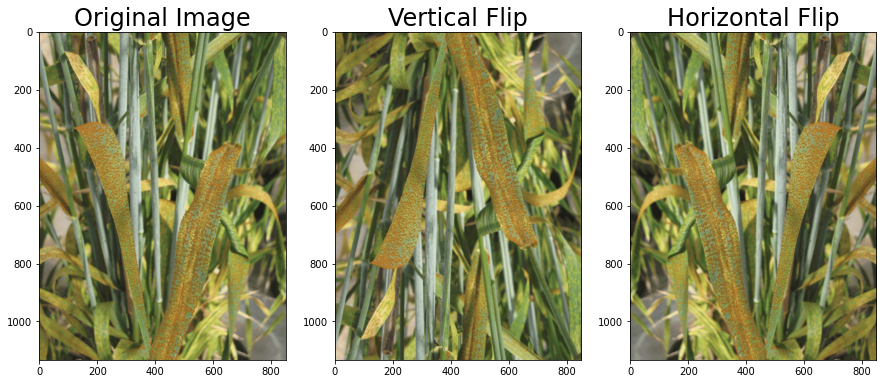

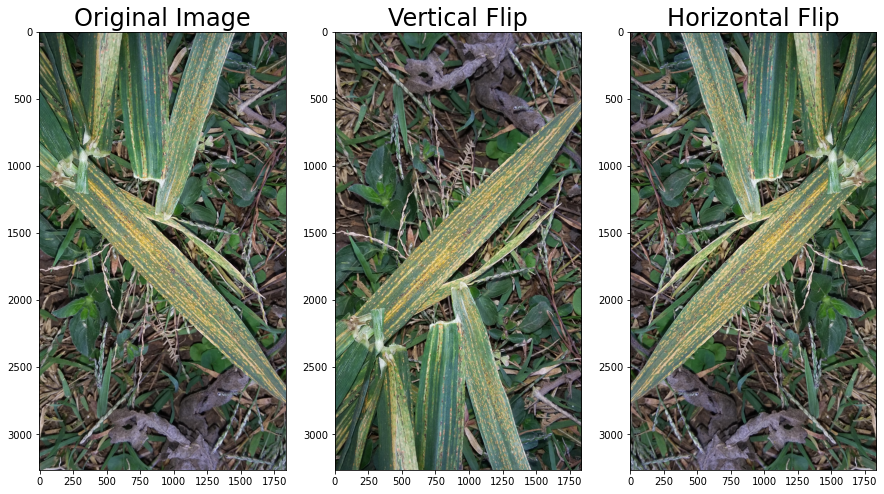

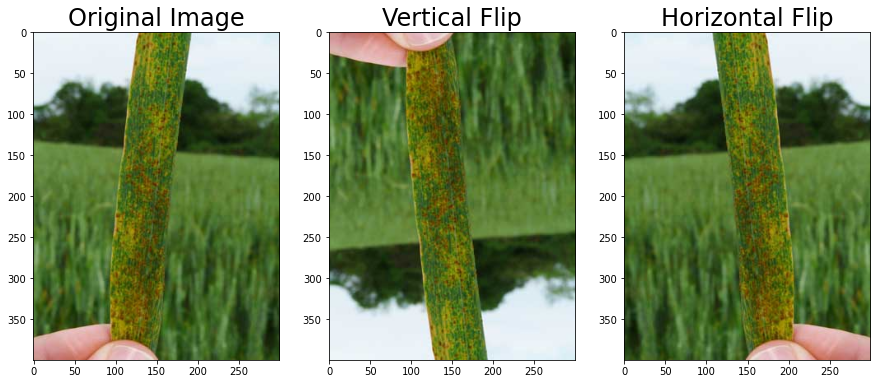

In [ ]:
invert(train_images[3])
invert(train_images[4])
invert(train_images[5])

We can see that the images are simply flipped. All major features in the image remain the same, but to a computer algorithm, the flipped images look completely different. These transformations can be used for data augmentation, making models more robust and accurate.

## Convolution <a id="2.3"></a>

Convolution is a rather simple algorithm which involves a kernel (a 2D matrix) which moves over the entire image, calculating dot products with each window along the way. The GIF below demonstrates convolution in action.

<center><img src="https://i.imgur.com/wYUaqR3.gif" width="450px"></center>

The above process can be summarized with an equation, where *f* is the image and *h* is the kernel. The dimensions of *f* are *(m, n)* and the kernel is a square matrix with dimensions smaller than *f*:

<center><img src="https://i.imgur.com/9scTOGv.png" width="350px"></center>
<br>

In the above equation, the kernel *h* is moving across the length and breadth of the image. The dot product of *h* with a sub-matrix or window of matrix *f* is taken at each step, hence the double summation (rows and columns). Below I demonstrate the effect of convolution on leaf images.

In [ ]:
def conv(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    kernel = np.ones((7, 7), np.float32)/25
    conv = cv2.filter2D(img, -1, kernel)
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(conv)
    ax[1].set_title('Convolved Image', fontsize=24)
    plt.show()

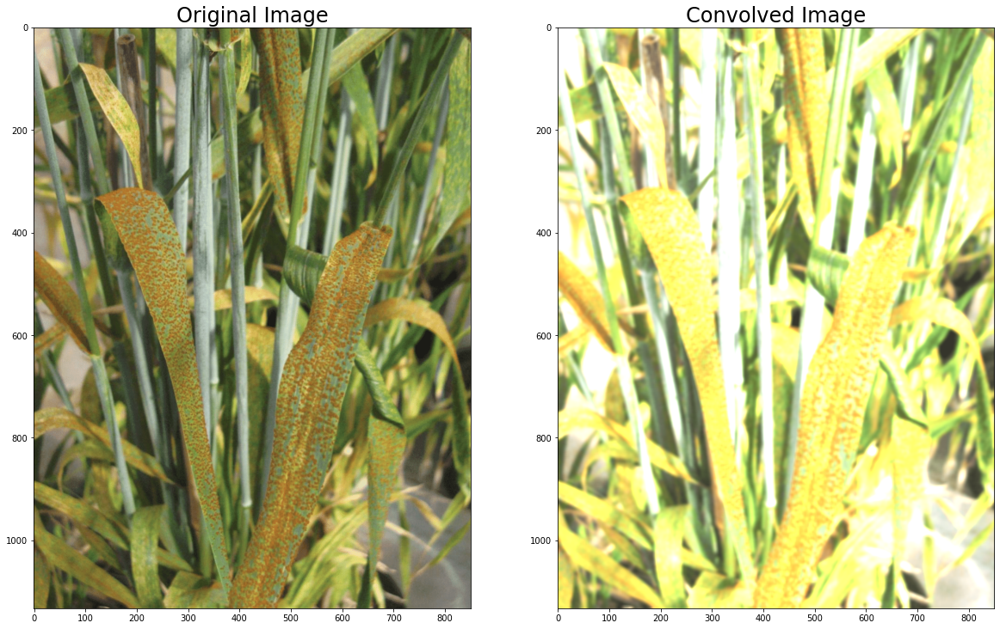

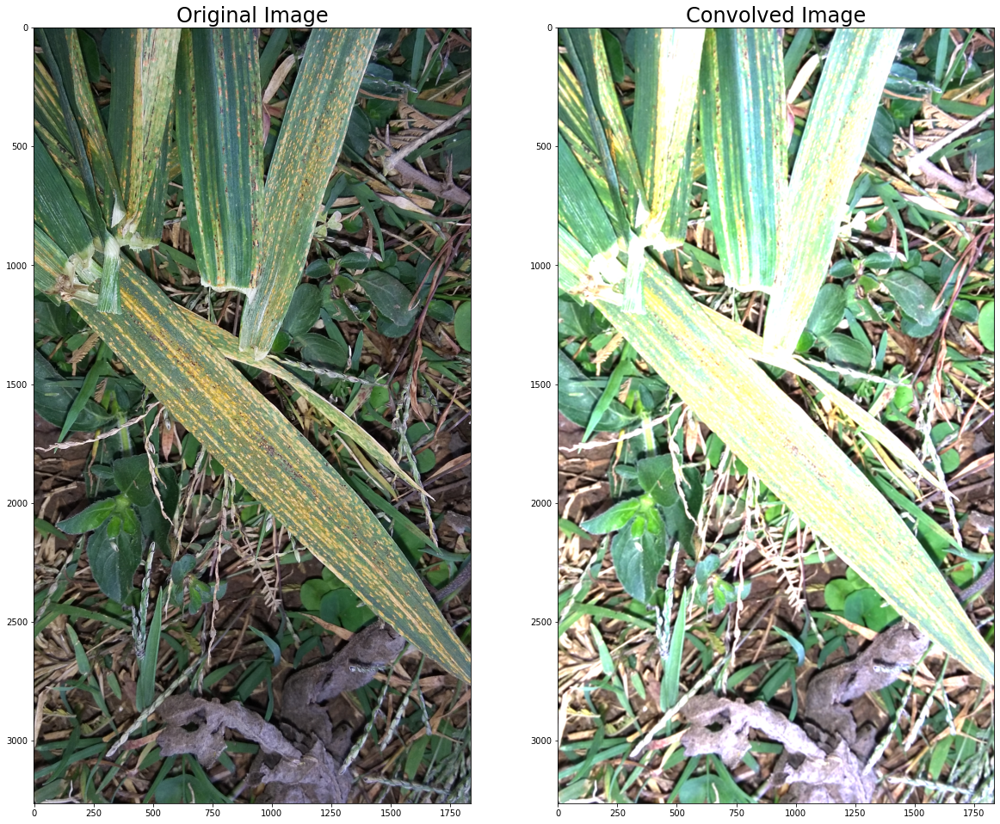

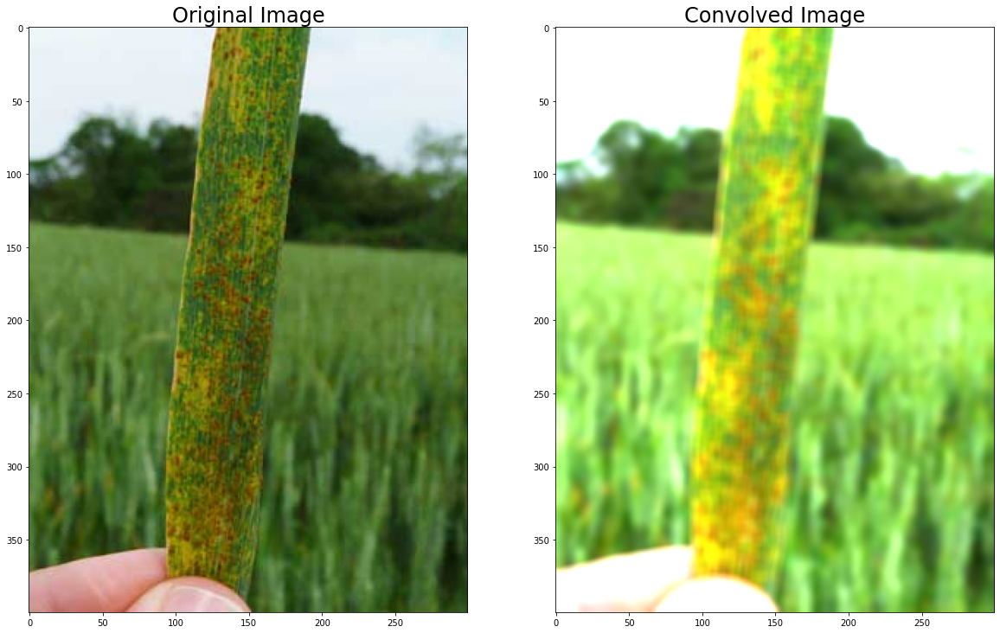

In [ ]:
conv(train_images[3])
conv(train_images[4])
conv(train_images[5])

The convolution operator seems to have an apparent "sunshine" effect of the images. This may also serve the purpose of augmenting the data, thus helping to build more robust and accurate models.

## Blurring <a id="2.4"></a>

Blurring is simply the addition of noise to the image, resulting in a less-clear image. The noise can be sampled from any distribution of choice, as long as the main content in the image does not become invisible. Only the minor details get obfuscated due to blurring. The blurring transformation can be represented using the equation below.

<center><img src="https://i.imgur.com/zVM8HCU.png" width="220px"></center>
<br>

The example uses a Gaussian distribution with mean 0 and variance 0.1. Below I demonstrate the effect of blurring on a few leaf images:

In [ ]:
def blur(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.blur(img, (100, 100)))
    ax[1].set_title('Blurred Image', fontsize=24)
    plt.show()

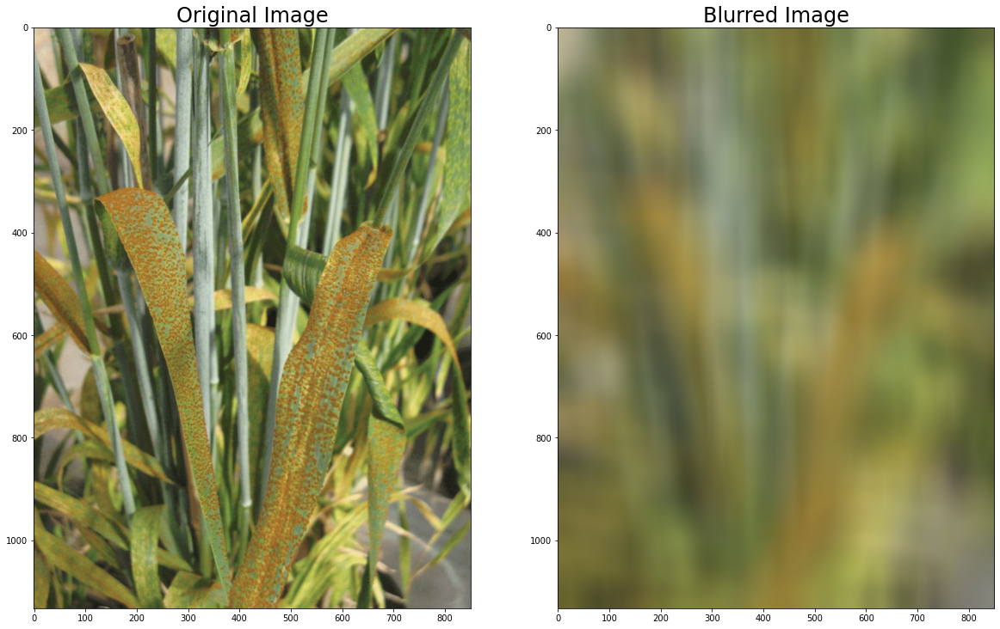

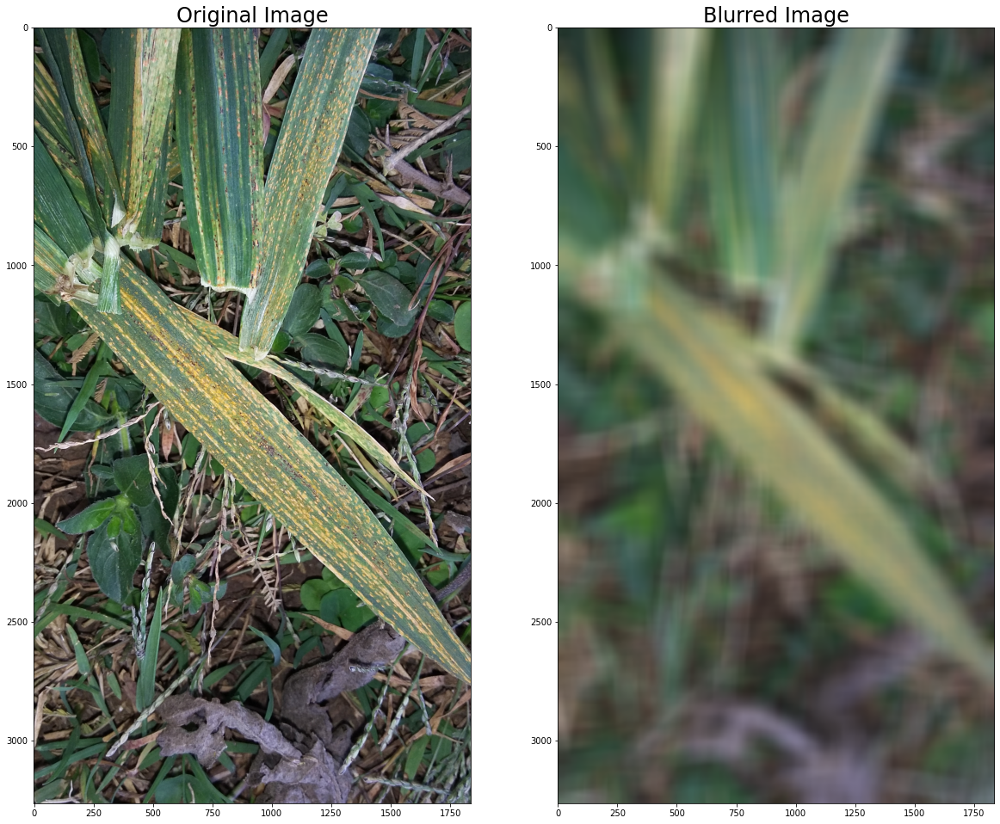

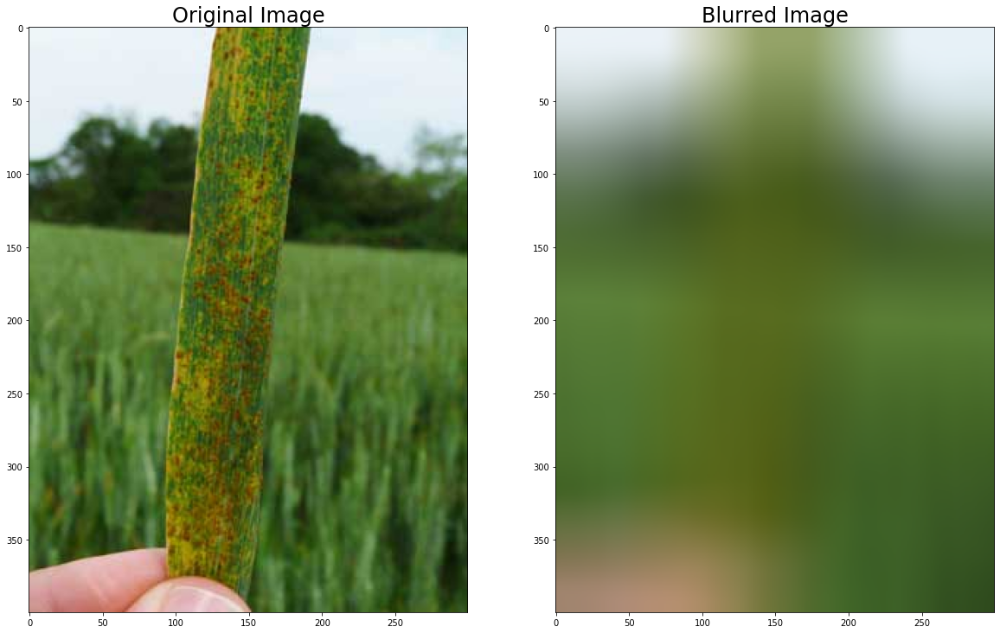

In [ ]:
blur(train_images[3])
blur(train_images[4])
blur(train_images[5])

The transformation clearly blurs the image by removing detailed, low-level features, while retaining the major, high-level features. This is once again a great way to augment images and train more robust models.